# Energy A.I. Hackathon 2025 Workflow - [Your Team Name]

Authors: Satvik Duddukuru (Departments of Computer Science and Mathematics, CNS), Joshua Yue (Departments of Computer Science and Mathematics, CNS), Parth Gupta (Department of Computer Science, CNS), Akshat Kumar (Department of Computer Science, CNS), Rashed Alsuhabi (Hildebrand Department of Petroleum and Geosystems, Cockrell School of Engineering)

The University of Texas at Austin, Austin, Texas, USA

### Executive Summary

1. Our goal: predict the energy required for hydraulic fracturing. 
2. What we did: cleaned data, implemented a categorical boost (CatBoost) algorithm, and developed an uncertainty model with data augmentation.
3. Learnings: building an effective workflow for categorical data sets, and understanding hydraulic fracturing problems. 
4. Recommendation: data thrives in numbers; more comprehensive data will benefit future endeavors. 


### Workflow Goal

The goal of this workflow is to gain a better understanding of the data available to us and use it to predict the target labels, namely energy consumption by type. 

### Workflow Steps

 - Data cleaning and imputation: dealing with missing values and combining targets
 - Feature selection: selecting the most important features
 - Model building: constructing the models to use for prediction
 - Uncertainty modeling: calculating realizations
 - Analysis: evaluating the results 

# Imports and style

In [1]:
import bisect
from catboost import CatBoostRegressor
import ipywidgets as widgets
from IPython.display import display
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import norm
import seaborn as sns
from sklearn.base import clone
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVR
from tqdm import tqdm

In [2]:
sns.set_theme()

# Data

Read the dataframe from "HackData2025.csv" and remove extraneous whitespace from columns

In [3]:
df = pd.read_csv("HackathonData2025.csv").sample(frac=1).reset_index(drop=True)
df.columns = [i.rstrip() for i in df.columns]
df

,Well Name,# Stages,# Clusters,Estimated Average Stage Time,Actual Average Stage Time,Frac Fleet,Fleet Type,Target Formation,Field Area,Ambient Temperature,Grid,Diesel,CNG,Fuel Type,Sand Provider
0,Peoria 2H,64,404,120.0,NaN,Fleet 1,Simul,Longhorn,West Campus,82.7,0,0,19707,Turbine,SAND_C_R
1,Pike 3H,84,561,95.2,113.1,Fleet 8,Zipper,Cowboy,DKR,67.7,0,90171,1521,DGB,SAND_C_A
2,Atkinson 5H,75,478,85.7,98.7,Fleet 6,Zipper,Lone Star,Gregory Gym,64.8,0,58830,17303,DGB,SAND_C_X
3,Watonwan 2H,51,406,106.7,120.4,Fleet 2,Simul,Bluebonnet,Guadalupe,76.3,0,0,11618,Turbine,SAND_C_X
4,Grand 5H,49,304,106.7,NaN,Fleet 7,Simul,Monarch Butterfly,DKR,NaN,0,19605,8117,DGB,SAND_C_R
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1077,Hillsborough 1H,42,290,NaN,126.7,Fleet 12,Simul,Bluebonnet,Moody Center,86.6,0,78614,0,Diesel,SAND_C_X
1078,Pinellas 5H,64,475,115.2,127.7,Fleet 2,Simul,Rodeo,West Campus,74.5,1390290,0,0,Grid,SAND_C_R
1079,Ware 6H,76,501,96.0,110.5,Fleet 9,Simul,Cowboy,Moody Center,81.6,0,16627,17257,DGB,SAND_C_X
1080,Greenlee 6H,75,554,106.7,119.3,Fleet 14,Simul,Bluebonnet,West Campus,NaN,0,104544,0,Diesel,SAND_C_X


Correlation heatmap to get an idea of how the features might be related

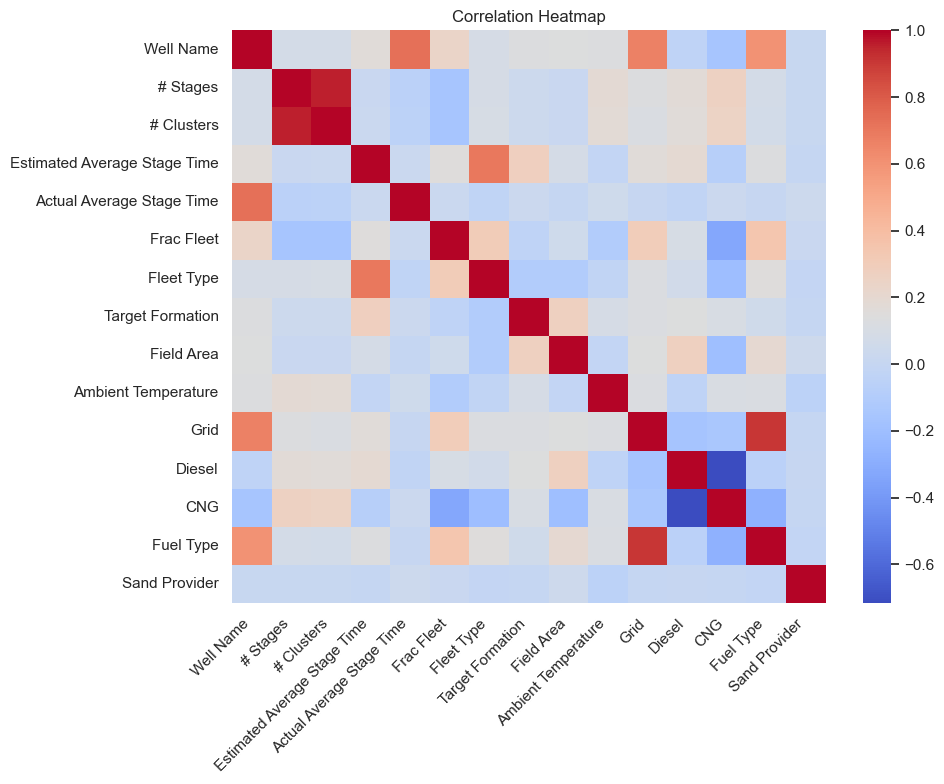

In [4]:
def compute_correlation(df):
    """
    Compute a correlation matrix for both numerical and categorical features using:
    - Pearson correlation for numerical features.
    - ANOVA to assign numerical values to categorical features, enabling Pearson correlation computation.
    """
    # Separate numerical and categorical columns
    numerical_cols = df.select_dtypes(include=[np.number]).columns
    categorical_cols = df.select_dtypes(exclude=[np.number]).columns

    # Convert categorical columns to numerical using ANOVA F-statistics
    cat_to_num = {}
    for cat_col in categorical_cols:
        unique_vals = df[cat_col].unique()
        groups = [df[df[cat_col] == val][numerical_cols].mean().values for val in unique_vals]
        group_means = {val: np.mean(group) for val, group in zip(unique_vals, groups)}
        cat_to_num[cat_col] = df[cat_col].map(group_means)

    # Replace categorical columns with their numerical representation
    for cat_col in cat_to_num:
        df[cat_col] = cat_to_num[cat_col]

    # Compute Pearson correlation for all columns
    corr_matrix = df.corr()

    return corr_matrix

def plot_correlation_heatmap(df):
    """
    Generate a heatmap of Pearson correlation for the dataframe after converting categorical columns.
    """
    # Create a copy of the dataframe to avoid modifying the original
    df_copy = df.copy()
    corr_matrix = compute_correlation(df_copy)

    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_matrix, annot=False, fmt=".2f", cmap="coolwarm", cbar=True, 
                xticklabels=corr_matrix.columns, yticklabels=corr_matrix.index)
    plt.title("Correlation Heatmap")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

plot_correlation_heatmap(df)

Some data is missing

In [5]:
df.isna().any()

Well Name                       False
# Stages                        False
# Clusters                      False
Estimated Average Stage Time     True
Actual Average Stage Time        True
Frac Fleet                      False
Fleet Type                       True
Target Formation                False
Field Area                      False
Ambient Temperature              True
Grid                            False
Diesel                          False
CNG                             False
Fuel Type                       False
Sand Provider                   False
dtype: bool

Clearly, time cannot be negative (in this context)

In [6]:
df[df["Actual Average Stage Time"] < 0] = np.NaN

Since each well name consists of a name and a letter-number combination, break these up into two features

In [7]:
df["Well Name 1"] = df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[0] if type(x) is str else x)
df["Well Name 2"] = df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[1] if type(x) is str else x)
df = df.drop("Well Name", axis=1)

Check if there is a linear correlation between estimated and actual stage time

In [8]:
times_no_nan = df.loc[:, ["Estimated Average Stage Time", "Actual Average Stage Time"]].dropna()

lr_model_time = LinearRegression()
lr_model_time.fit(
    times_no_nan[["Estimated Average Stage Time"]], 
    times_no_nan["Actual Average Stage Time"]
)
lr_model_time.score(
    times_no_nan[["Estimated Average Stage Time"]], 
    times_no_nan["Actual Average Stage Time"]
), lr_model_time.coef_[0], lr_model_time.intercept_

(0.6025454261037835, 0.7861168265995576, 32.57168922682803)

/Users/satvikduddukuru/Programming/Python/miniforge3/lib/python3.9/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


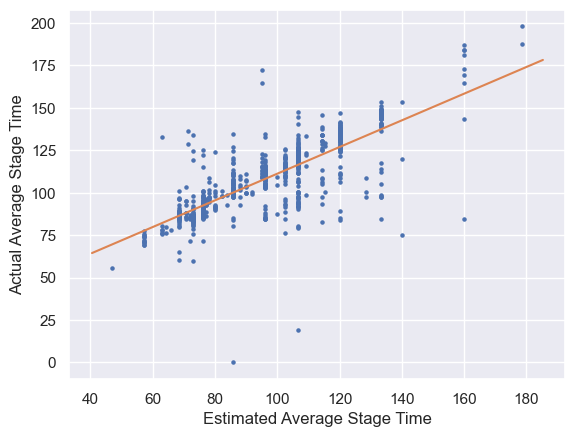

In [9]:
plt.scatter(
    df["Estimated Average Stage Time"],
    df["Actual Average Stage Time"],
    s=5
)
lr_x = np.array(plt.gca().get_xlim()).reshape(-1, 1)
lr_y = lr_model_time.predict(lr_x)
plt.plot(lr_x, lr_y, color="C1")
plt.xlabel("Estimated Average Stage Time")
plt.ylabel("Actual Average Stage Time")
plt.show()

Impute missing data for estimated and average stage time by using the linear model trained above

In [10]:
df = df.dropna(how="all", subset=["Estimated Average Stage Time", "Actual Average Stage Time"])
df = df.reset_index(drop=True)
est_time_missing = np.where(df.loc[:, "Estimated Average Stage Time"].isna())[0]
actual_time_missing = np.where(df.loc[:, "Actual Average Stage Time"].isna())[0]
df.loc[actual_time_missing, "Actual Average Stage Time"] = lr_model_time.predict(
    df.iloc[actual_time_missing][["Estimated Average Stage Time"]]
)
df.loc[est_time_missing, "Estimated Average Stage Time"] = (
    lr_model_time.coef_[0] * df.iloc[est_time_missing]["Actual Average Stage Time"]
) + lr_model_time.intercept_
df = df.drop("Actual Average Stage Time", axis=1)

Since a small number of samples have missing Fleet Type, it is safe to drop those samples

In [11]:
df = df.dropna(subset=["Fleet Type"])
df = df.reset_index(drop=True)

We don't necessarily care about time per stage and the number of stages independently; instead, calculate the total time

In [12]:
df["Total Estimated Stage Time"] = df["Estimated Average Stage Time"] * df["# Stages"]
estimated_average_stage_times = df["Estimated Average Stage Time"]
df = df.drop("Estimated Average Stage Time", axis=1)
df = df.drop("# Stages", axis=1)

For samples with missing ambient temperature, impute with a CatBoostRegressor

In [13]:
def make_categorical(full_df, col):
    full_df[col] = full_df[col].astype("category")
    return full_df

In [14]:
def get_categorical_columns(df):
    return list(df.select_dtypes(include="category").columns)

In [15]:
original_temp = df["Ambient Temperature"].copy()

X_at = df.loc[:, df.columns != "Ambient Temperature"]
X_at = df.loc[:, [i for i in X_at.columns if i not in ["CNG", "Diesel", "Grid", "Total Estimated Stage Time", "Total Energy Usage"]]]
for col in X_at.columns:
    if str(X_at[col].dtype) == "object":
        X_at = make_categorical(X_at, col)

y_at = df.loc[:, "Ambient Temperature"]
X_at_clean, y_at_clean = X_at[~y_at.isna()], y_at[~y_at.isna()]
at_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X_at))
grid = {
    "iterations": [500, 1000, 2000, 5000],
    "learning_rate": [0.005, 0.01, 0.05, 0.1],
    "depth": [2, 4, 6, 8, 10],
    "l2_leaf_reg": [1, 3, 5, 7, 10],
    "min_data_in_leaf": [1, 5, 10, 20, 50],
    "subsample": [0.7, 0.8, 0.9, 1.0],
    "bagging_temperature": [0.1, 0.25, 0.5, 1],
    "random_strength": [1, 3, 5],
    "grow_policy": ["SymmetricTree", "Depthwise", "Lossguide"]
}
at_model.randomized_search(grid, X_at_clean, y_at_clean)
pred_at = pd.Series(at_model.predict(X_at))
df["Ambient Temperature"] = df["Ambient Temperature"].fillna(pred_at)
df = df.drop("Field Area", axis=1)


0:	learn: 66.9653093	test: 69.5619017	best: 69.5619017 (0)	total: 79.4ms	remaining: 39.6s
1:	learn: 66.3692952	test: 68.9731352	best: 68.9731352 (1)	total: 83.8ms	remaining: 20.9s
2:	learn: 65.8024445	test: 68.4052840	best: 68.4052840 (2)	total: 89.7ms	remaining: 14.9s
3:	learn: 65.2345129	test: 67.8337156	best: 67.8337156 (3)	total: 93.6ms	remaining: 11.6s
4:	learn: 64.6678562	test: 67.2682731	best: 67.2682731 (4)	total: 97.6ms	remaining: 9.66s
5:	learn: 64.1265759	test: 66.7350041	best: 66.7350041 (5)	total: 101ms	remaining: 8.29s
6:	learn: 63.5748644	test: 66.1886365	best: 66.1886365 (6)	total: 104ms	remaining: 7.34s
7:	learn: 63.0192740	test: 65.6362533	best: 65.6362533 (7)	total: 107ms	remaining: 6.58s
8:	learn: 62.4868330	test: 65.1082003	best: 65.1082003 (8)	total: 111ms	remaining: 6.07s
9:	learn: 61.9430288	test: 64.5631629	best: 64.5631629 (9)	total: 114ms	remaining: 5.61s
10:	learn: 61.4139348	test: 64.0265891	best: 64.0265891 (10)	total: 118ms	remaining: 5.26s
11:	learn: 60.

Since the distributions look similar, we don't have too much bias

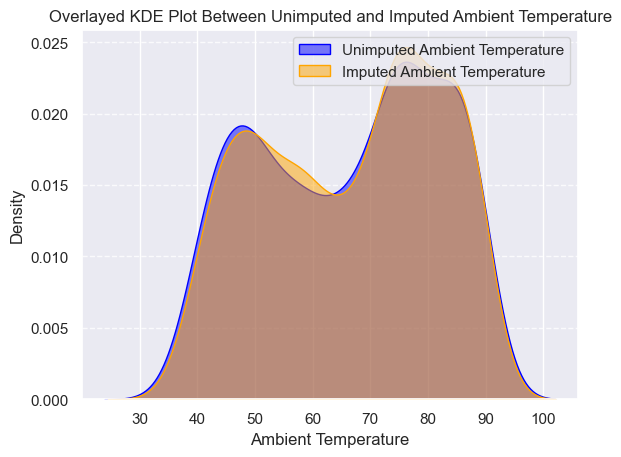

In [16]:
sns.kdeplot(original_temp, fill=True, alpha=0.5, color="blue", label="Unimputed Ambient Temperature")
sns.kdeplot(df["Ambient Temperature"].values, fill=True, alpha=0.5, color="orange", label="Imputed Ambient Temperature")
plt.title("Overlayed KDE Plot Between Unimputed and Imputed Ambient Temperature")
plt.xlabel("Ambient Temperature")
plt.ylabel("Density")
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.8)
plt.show()

Combine the target labels so they are in the same units and sum the energy usage by field type

`diesel_scale` and `cng_scale` were determined by a combination of cursory searching and empirical evaluation

In [17]:
diesel_scale = 0.3 * 37.95
cng_scale = 0.3125 * 293.071
df["Total Energy Usage"] = df["Grid"] + df["Diesel"] * diesel_scale + df["CNG"] * cng_scale

In [18]:
diesel_values = df.loc[df["Fuel Type"] == "DGB"]["Diesel"] * diesel_scale
cng_values = df.loc[df["Fuel Type"] == "DGB"]["CNG"] * cng_scale

The Sand Provider does not seem to matter

In [19]:
df = df.drop("Sand Provider", axis=1)

Split the df by fuel type for convenient experimentation

In [20]:
fuel_types = df["Fuel Type"].unique()
split_dfs = {
    fuel_type: df[df["Fuel Type"] == fuel_type].drop("Fuel Type", axis=1).reset_index(drop=True)
    for fuel_type in fuel_types
}
fuel_types = np.append(fuel_types, "Full")
split_dfs["Full"] = df.drop("Fuel Type", axis=1).reset_index(drop=True)

In [21]:
targets = ["Grid", "Diesel", "CNG", "Total Energy Usage"]
feature_dfs = {
    fuel_type: split_dfs[fuel_type][[i for i in split_dfs[fuel_type].columns if i not in targets]]
    for fuel_type in fuel_types
}
target_dfs = {
    fuel_type: split_dfs[fuel_type][targets]
    for fuel_type in fuel_types
}

Mark categorical variables as categorical

In [22]:
for feature_df in feature_dfs.values():
    for col in feature_df.columns:
        if str(feature_df[col].dtype) == "object":
            feature_df = make_categorical(feature_df, col)

/var/folders/d0/rmsqt49959q7xz073h4cx29r0000gn/T/ipykernel_56901/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df[col] = full_df[col].astype("category")
/var/folders/d0/rmsqt49959q7xz073h4cx29r0000gn/T/ipykernel_56901/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df[col] = full_df[col].astype("category")
/var/folders/d0/rmsqt49959q7xz073h4cx29r0000gn/T/ipykernel_56901/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

Drop samples with values more than 2 standard deviations from the center if `want_to_drop_outliers` is set to `True`

In [23]:
def drop_outliers(feature_df, target_df):
    feature_df = feature_df[feature_df.apply(lambda x : (x-x.mean()).abs()<(2*x.std()) if not pd.api.types.is_categorical_dtype(x) else x).all(1)]
    return feature_df.reset_index(drop=True), target_df.iloc[feature_df.index].reset_index(drop=True)

In [24]:
want_to_drop_outliers = False

In [25]:
if want_to_drop_outliers:
    for fuel_type in fuel_types:
        feature_dfs[fuel_type], target_dfs[fuel_type] = drop_outliers(feature_dfs[fuel_type], target_dfs[fuel_type])

Utility function to get target dataframe for the desired fuel_type

In [26]:
def get_target_df(fuel_type):
    if fuel_type == "Turbine":
        return target_dfs[fuel_type]["CNG"]
    elif fuel_type == "Grid":
        return target_dfs[fuel_type]["Grid"]
    elif fuel_type == "Diesel":
        return target_dfs[fuel_type]["Diesel"]
    elif fuel_type == "DGB":
        return target_dfs[fuel_type][["Diesel", "CNG"]]
    elif fuel_type == "Full":
        return target_dfs[fuel_type]["Total Energy Usage"]

# Modelling

Function to train CatBoostRegressors with K-fold cross-validation and return model performance and the models themselves

In [27]:
def score_model_cat(model, feature_df, target_df, num_folds=5, use_grid=False):
    scores = []
    models = []
    y_pred = []
    y_true = []
    for i in tqdm(range(num_folds)):
        start = len(feature_df) * i // num_folds
        end = len(feature_df) * (i+1) // num_folds
        fold = feature_df.index.isin(range(start, end))
        m = clone(model)
        m.set_params(eval_metric="RMSE")
        grid = {
            "iterations": [500, 1000, 2000, 5000],
            "learning_rate": [0.005, 0.01, 0.05, 0.1],
            "depth": [2, 4, 6, 8, 10],
            "l2_leaf_reg": [1, 3, 5, 7, 10],
            "min_data_in_leaf": [1, 5, 10, 20, 50],
            "subsample": [0.7, 0.8, 0.9, 1.0],
            "bagging_temperature": [0.1, 0.25, 0.5, 1],
            "random_strength": [1, 3, 5],
            "grow_policy": ["SymmetricTree", "Depthwise", "Lossguide"]
        }
        if use_grid:
            m.randomized_search(grid, feature_df[~fold], target_df[~fold])
        else:
            m.fit(feature_df[~fold], target_df[~fold])
        predictions = m.predict(feature_df[fold])
        scores.append(mean_absolute_percentage_error(target_df[fold], predictions))
        models.append(m)
        y_pred += list(predictions)
        y_true += list(target_df[fold])
    return scores, models, y_true, y_pred

## Feature selection

Fit a CatBoostRegressor to the entire dataset to get feature importances

In [28]:
X, y = feature_dfs["Full"], get_target_df("Full")

In [29]:
model = CatBoostRegressor(one_hot_max_size=100, cat_features=list(X.select_dtypes(include="category").columns))
scores, models, y_true, y_pred = score_model_cat(model, X, y, use_grid=False)

  0%|          | 0/5 [00:00<?, ?it/s]

Learning rate set to 0.0398
0:	learn: 437328.9830031	total: 1.71ms	remaining: 1.71s
1:	learn: 428196.1303666	total: 2.58ms	remaining: 1.29s
2:	learn: 421117.4650018	total: 3.18ms	remaining: 1.05s
3:	learn: 414683.6561869	total: 3.72ms	remaining: 926ms
4:	learn: 407037.3755246	total: 4.5ms	remaining: 896ms
5:	learn: 399294.9516155	total: 5.28ms	remaining: 875ms
6:	learn: 391284.6667060	total: 6.05ms	remaining: 858ms
7:	learn: 384291.3186434	total: 6.93ms	remaining: 860ms
8:	learn: 378283.7128634	total: 7.39ms	remaining: 813ms
9:	learn: 370008.6250267	total: 8.2ms	remaining: 812ms
10:	learn: 363730.0090953	total: 8.97ms	remaining: 806ms
11:	learn: 357192.9562733	total: 9.72ms	remaining: 800ms
12:	learn: 350317.3495916	total: 10.5ms	remaining: 797ms
13:	learn: 343938.2025160	total: 11.4ms	remaining: 800ms
14:	learn: 338612.1772147	total: 12.2ms	remaining: 799ms
15:	learn: 333645.8563921	total: 13.1ms	remaining: 804ms
16:	learn: 328039.9659234	total: 13.9ms	remaining: 804ms
17:	learn: 3223

 20%|██        | 1/5 [00:00<00:03,  1.15it/s]

945:	learn: 68900.1205566	total: 762ms	remaining: 43.5ms
946:	learn: 68872.0063719	total: 763ms	remaining: 42.7ms
947:	learn: 68798.4561664	total: 763ms	remaining: 41.9ms
948:	learn: 68733.4034745	total: 764ms	remaining: 41.1ms
949:	learn: 68685.4896706	total: 765ms	remaining: 40.2ms
950:	learn: 68600.6659361	total: 765ms	remaining: 39.4ms
951:	learn: 68484.9728902	total: 766ms	remaining: 38.6ms
952:	learn: 68418.7538307	total: 767ms	remaining: 37.8ms
953:	learn: 68378.7601524	total: 768ms	remaining: 37ms
954:	learn: 68353.1133498	total: 769ms	remaining: 36.2ms
955:	learn: 68351.2995733	total: 770ms	remaining: 35.4ms
956:	learn: 68262.0830291	total: 770ms	remaining: 34.6ms
957:	learn: 68201.3963130	total: 771ms	remaining: 33.8ms
958:	learn: 68139.1514795	total: 772ms	remaining: 33ms
959:	learn: 68076.1374926	total: 772ms	remaining: 32.2ms
960:	learn: 68033.6909928	total: 773ms	remaining: 31.4ms
961:	learn: 67952.2418920	total: 775ms	remaining: 30.6ms
962:	learn: 67933.5483223	total: 77

 40%|████      | 2/5 [00:01<00:02,  1.08it/s]

Learning rate set to 0.039793
0:	learn: 443867.0991038	total: 793us	remaining: 793ms
1:	learn: 434675.4199982	total: 1.54ms	remaining: 771ms
2:	learn: 427544.2757478	total: 2.07ms	remaining: 689ms
3:	learn: 418771.6411070	total: 2.58ms	remaining: 643ms
4:	learn: 409939.6543216	total: 3.54ms	remaining: 704ms
5:	learn: 402025.6861961	total: 4.52ms	remaining: 749ms
6:	learn: 395392.1864777	total: 5.45ms	remaining: 773ms
7:	learn: 386786.8779036	total: 6.24ms	remaining: 773ms
8:	learn: 379445.8735669	total: 7.03ms	remaining: 774ms
9:	learn: 372125.3551165	total: 7.74ms	remaining: 766ms
10:	learn: 365411.7164848	total: 8.41ms	remaining: 756ms
11:	learn: 359179.2099991	total: 9.13ms	remaining: 752ms
12:	learn: 353527.5139901	total: 9.92ms	remaining: 753ms
13:	learn: 346480.5323532	total: 10.8ms	remaining: 762ms
14:	learn: 340307.7690597	total: 11.7ms	remaining: 767ms
15:	learn: 333567.6818720	total: 12.4ms	remaining: 765ms
16:	learn: 328261.4772405	total: 13.3ms	remaining: 768ms
17:	learn: 3

 60%|██████    | 3/5 [00:02<00:01,  1.03it/s]

Learning rate set to 0.039793
0:	learn: 440541.8457529	total: 1.78ms	remaining: 1.77s
1:	learn: 432557.0677191	total: 2.73ms	remaining: 1.36s
2:	learn: 425626.6779629	total: 3.22ms	remaining: 1.07s
3:	learn: 416714.7855423	total: 3.65ms	remaining: 909ms
4:	learn: 407773.1111251	total: 4.63ms	remaining: 920ms
5:	learn: 399854.9839045	total: 5.36ms	remaining: 888ms
6:	learn: 393153.6134911	total: 6.2ms	remaining: 879ms
7:	learn: 384737.7714161	total: 7.1ms	remaining: 880ms
8:	learn: 377592.9671441	total: 8.12ms	remaining: 894ms
9:	learn: 370060.4888604	total: 9ms	remaining: 891ms
10:	learn: 362859.0344673	total: 9.79ms	remaining: 880ms
11:	learn: 356548.5388951	total: 10.6ms	remaining: 875ms
12:	learn: 349953.0190016	total: 11.6ms	remaining: 882ms
13:	learn: 342466.3254912	total: 12.5ms	remaining: 883ms
14:	learn: 336588.5231603	total: 13.4ms	remaining: 882ms
15:	learn: 330016.0969317	total: 14.2ms	remaining: 871ms
16:	learn: 324763.6192200	total: 15ms	remaining: 869ms
17:	learn: 319975.

 80%|████████  | 4/5 [00:03<00:00,  1.05it/s]

871:	learn: 68451.8496523	total: 756ms	remaining: 111ms
872:	learn: 68398.3579459	total: 757ms	remaining: 110ms
873:	learn: 68339.4875873	total: 758ms	remaining: 109ms
874:	learn: 68268.3850705	total: 759ms	remaining: 108ms
875:	learn: 68232.3555926	total: 759ms	remaining: 107ms
876:	learn: 68155.8549514	total: 760ms	remaining: 107ms
877:	learn: 68053.2405785	total: 761ms	remaining: 106ms
878:	learn: 68022.8968260	total: 762ms	remaining: 105ms
879:	learn: 67995.6760338	total: 762ms	remaining: 104ms
880:	learn: 67982.3361653	total: 763ms	remaining: 103ms
881:	learn: 67909.6700826	total: 764ms	remaining: 102ms
882:	learn: 67856.8206087	total: 765ms	remaining: 101ms
883:	learn: 67829.5305175	total: 765ms	remaining: 100ms
884:	learn: 67775.4048935	total: 766ms	remaining: 99.5ms
885:	learn: 67719.7829292	total: 767ms	remaining: 98.6ms
886:	learn: 67676.1816587	total: 768ms	remaining: 97.8ms
887:	learn: 67626.0510649	total: 768ms	remaining: 96.9ms
888:	learn: 67554.9239050	total: 769ms	remai

100%|██████████| 5/5 [00:04<00:00,  1.08it/s]

813:	learn: 69868.3298956	total: 651ms	remaining: 149ms
814:	learn: 69813.6206151	total: 652ms	remaining: 148ms
815:	learn: 69773.6669880	total: 653ms	remaining: 147ms
816:	learn: 69734.8819553	total: 654ms	remaining: 146ms
817:	learn: 69666.1015690	total: 654ms	remaining: 146ms
818:	learn: 69646.8819409	total: 655ms	remaining: 145ms
819:	learn: 69518.4956274	total: 656ms	remaining: 144ms
820:	learn: 69473.1557984	total: 656ms	remaining: 143ms
821:	learn: 69381.3208924	total: 657ms	remaining: 142ms
822:	learn: 69346.8632979	total: 658ms	remaining: 141ms
823:	learn: 69275.8936043	total: 659ms	remaining: 141ms
824:	learn: 69244.9579013	total: 659ms	remaining: 140ms
825:	learn: 69127.1193719	total: 661ms	remaining: 139ms
826:	learn: 69019.4013430	total: 662ms	remaining: 138ms
827:	learn: 68955.2493728	total: 663ms	remaining: 138ms
828:	learn: 68883.0530566	total: 664ms	remaining: 137ms
829:	learn: 68862.6435971	total: 664ms	remaining: 136ms
830:	learn: 68767.8497707	total: 665ms	remaining

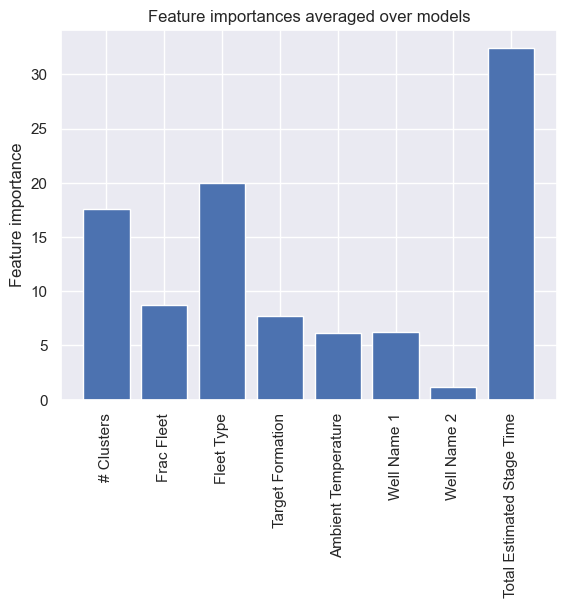

In [30]:
plt.bar(models[0].feature_names_, np.mean([i.feature_importances_ for i in models], axis=0))
plt.ylabel("Feature importance")
plt.title("Feature importances averaged over models")
plt.xticks(rotation=90)
plt.show()

In [31]:
num_features_to_include = 7 # chosen by inspection of the bar graph
important_features = [np.asarray(m.feature_names_)[np.argwhere(m.feature_importances_ >= np.partition(m.feature_importances_, -num_features_to_include)[-num_features_to_include])].reshape(1, -1).tolist()[0] for m in models][0]

## Training

Fit a CatBoostRegressor on the important features with cross-validation

In [32]:
model2 = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X[important_features]))
scores, models, y_true, y_pred = score_model_cat(model2, X[important_features], y, use_grid=True)

  0%|          | 0/5 [00:00<?, ?it/s]

0:	learn: 1412412.5709392	test: 1378220.3733016	best: 1378220.3733016 (0)	total: 5.11ms	remaining: 2.55s
1:	learn: 1400352.6607779	test: 1366419.9854569	best: 1366419.9854569 (1)	total: 9.31ms	remaining: 2.32s
2:	learn: 1388290.4689499	test: 1354805.0850044	best: 1354805.0850044 (2)	total: 14.6ms	remaining: 2.42s
3:	learn: 1376659.9160305	test: 1342887.9009497	best: 1342887.9009497 (3)	total: 19.7ms	remaining: 2.44s
4:	learn: 1364926.7971639	test: 1331734.8253511	best: 1331734.8253511 (4)	total: 23.8ms	remaining: 2.35s
5:	learn: 1353201.5947655	test: 1320361.2720534	best: 1320361.2720534 (5)	total: 28.2ms	remaining: 2.32s
6:	learn: 1341808.1083201	test: 1309341.8394952	best: 1309341.8394952 (6)	total: 32.4ms	remaining: 2.29s
7:	learn: 1330468.4858885	test: 1298175.0951001	best: 1298175.0951001 (7)	total: 35.9ms	remaining: 2.21s
8:	learn: 1319885.5085725	test: 1287655.7564993	best: 1287655.7564993 (8)	total: 41.7ms	remaining: 2.27s
9:	learn: 1308580.1172134	test: 1276692.5730229	best: 1

 20%|██        | 1/5 [01:37<06:29, 97.46s/it]

0:	learn: 1400408.8315987	test: 1412250.4229587	best: 1412250.4229587 (0)	total: 3.37ms	remaining: 1.68s
1:	learn: 1388721.5831739	test: 1400431.6719743	best: 1400431.6719743 (1)	total: 6.05ms	remaining: 1.51s
2:	learn: 1376980.4658442	test: 1388965.4602047	best: 1388965.4602047 (2)	total: 8.18ms	remaining: 1.35s
3:	learn: 1365792.7466471	test: 1377918.4915552	best: 1377918.4915552 (3)	total: 12.7ms	remaining: 1.57s
4:	learn: 1355132.8914592	test: 1367224.8757040	best: 1367224.8757040 (4)	total: 17.4ms	remaining: 1.72s
5:	learn: 1344048.6020192	test: 1356091.5697646	best: 1356091.5697646 (5)	total: 20.4ms	remaining: 1.68s
6:	learn: 1332674.6326072	test: 1344959.9464415	best: 1344959.9464415 (6)	total: 22.2ms	remaining: 1.56s
7:	learn: 1321268.1181435	test: 1333589.1227626	best: 1333589.1227626 (7)	total: 25.7ms	remaining: 1.58s
8:	learn: 1310271.5228275	test: 1322584.5576614	best: 1322584.5576614 (8)	total: 28.1ms	remaining: 1.53s
9:	learn: 1299198.0903273	test: 1311356.6966241	best: 1

 40%|████      | 2/5 [04:18<06:44, 134.94s/it]

0:	learn: 1402667.6995718	test: 1464279.8934470	best: 1464279.8934470 (0)	total: 2.18ms	remaining: 1.09s
1:	learn: 1391208.1760351	test: 1452385.3999074	best: 1452385.3999074 (1)	total: 3.14ms	remaining: 781ms
2:	learn: 1379474.8890571	test: 1440684.0075838	best: 1440684.0075838 (2)	total: 3.84ms	remaining: 637ms
3:	learn: 1368224.7431036	test: 1429276.0746108	best: 1429276.0746108 (3)	total: 4.69ms	remaining: 581ms
4:	learn: 1356973.0607893	test: 1417798.7981868	best: 1417798.7981868 (4)	total: 5.72ms	remaining: 566ms
5:	learn: 1346082.4495602	test: 1407078.9361428	best: 1407078.9361428 (5)	total: 6.5ms	remaining: 535ms
6:	learn: 1334361.3042499	test: 1395075.3934579	best: 1395075.3934579 (6)	total: 7.05ms	remaining: 496ms
7:	learn: 1322847.8026503	test: 1383135.5461790	best: 1383135.5461790 (7)	total: 8.13ms	remaining: 500ms
8:	learn: 1312467.3653561	test: 1372547.4644973	best: 1372547.4644973 (8)	total: 9.03ms	remaining: 492ms
9:	learn: 1301589.7289186	test: 1361610.7938899	best: 13

 60%|██████    | 3/5 [07:02<04:56, 148.17s/it]

0:	learn: 1398079.5754252	test: 1474493.6693291	best: 1474493.6693291 (0)	total: 1.03ms	remaining: 513ms
1:	learn: 1386501.5451958	test: 1462587.7418170	best: 1462587.7418170 (1)	total: 1.94ms	remaining: 484ms
2:	learn: 1374644.3904417	test: 1450973.0580984	best: 1450973.0580984 (2)	total: 2.4ms	remaining: 398ms
3:	learn: 1363315.3222796	test: 1439645.6891442	best: 1439645.6891442 (3)	total: 3ms	remaining: 372ms
4:	learn: 1351716.5136726	test: 1427667.6680747	best: 1427667.6680747 (4)	total: 3.94ms	remaining: 390ms
5:	learn: 1340538.7849069	test: 1416217.3529865	best: 1416217.3529865 (5)	total: 4.88ms	remaining: 402ms
6:	learn: 1329666.2725619	test: 1405720.4587916	best: 1405720.4587916 (6)	total: 5.65ms	remaining: 398ms
7:	learn: 1318728.7966748	test: 1394515.2056109	best: 1394515.2056109 (7)	total: 6.31ms	remaining: 388ms
8:	learn: 1307995.5591300	test: 1383632.0278835	best: 1383632.0278835 (8)	total: 7.17ms	remaining: 391ms
9:	learn: 1296682.5180869	test: 1372083.3808658	best: 13720

 80%|████████  | 4/5 [11:00<03:03, 183.58s/it]

0:	learn: 1416606.4560788	test: 1457175.7548446	best: 1457175.7548446 (0)	total: 769us	remaining: 384ms
1:	learn: 1405124.6744958	test: 1445387.5722114	best: 1445387.5722114 (1)	total: 2.03ms	remaining: 507ms
2:	learn: 1393140.5203087	test: 1433200.0210943	best: 1433200.0210943 (2)	total: 2.95ms	remaining: 488ms
3:	learn: 1381471.4024155	test: 1421587.6697118	best: 1421587.6697118 (3)	total: 4.04ms	remaining: 500ms
4:	learn: 1370342.1703501	test: 1410303.2064761	best: 1410303.2064761 (4)	total: 5.08ms	remaining: 503ms
5:	learn: 1359062.4998105	test: 1399020.6308118	best: 1399020.6308118 (5)	total: 6.03ms	remaining: 496ms
6:	learn: 1348002.0820104	test: 1387801.4731866	best: 1387801.4731866 (6)	total: 7.06ms	remaining: 497ms
7:	learn: 1336826.6320798	test: 1376288.4525831	best: 1376288.4525831 (7)	total: 7.96ms	remaining: 490ms
8:	learn: 1325665.1782997	test: 1365192.1760239	best: 1365192.1760239 (8)	total: 8.64ms	remaining: 471ms
9:	learn: 1314740.5595261	test: 1354025.9095084	best: 13

100%|██████████| 5/5 [14:15<00:00, 171.01s/it]


Function to get the coefficient of determination between two arrays (that are expected to be linearly correlated)

In [33]:
def get_r2(a, b):
    a = a.reshape(-1, 1)
    model = LinearRegression()
    model.fit(a, b)
    return model.score(a, b)

In [34]:
get_r2(np.asarray(y_true), y_pred) # pretty good

0.8775699283156535

Visualize predictions vs true energy usage

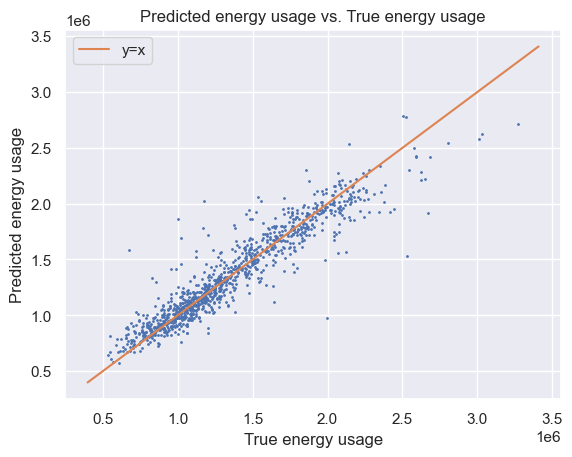

In [35]:
plt.scatter(y_true, y_pred, s=1)
plt.plot(plt.gca().get_xlim(), plt.gca().get_xlim(), color="C1", label="y=x")
plt.xlabel("True energy usage")
plt.ylabel("Predicted energy usage")
plt.title("Predicted energy usage vs. True energy usage")
plt.legend()
plt.show()

In [36]:
def get_stats(models, feature_df, target_df, feature_index=5):
    for model in models[:1]:
        res = model.calc_feature_statistics(feature_df, target_df, plot=True, feature=feature_index)
        plt.show()

In [37]:
feature_statistics_slider = widgets.IntSlider(value=0, min=0, max=len(X[important_features].columns)-1, step=1, description='Index:')
widgets.interactive(lambda row_number: get_stats(models, X[important_features], y, row_number), row_number=feature_statistics_slider)

interactive(children=(IntSlider(value=0, description='Index:', max=6), Output()), _dom_classes=('widget-intera…

In [38]:
y_pred_arr, y_true_arr = np.asarray(y_pred), np.asarray(y_true)

Visualize residuals

In [39]:
residuals = y_true_arr - y_pred_arr
mu, std = norm.fit(residuals)
residual_variance = std ** 2
uncertainty = residual_variance ** 0.5

In [40]:
def get_corr(alpha=0.5):
    z_scores = np.geomspace(0.01, 2.5)
    includeds = []
    for z_score in z_scores:
        lower_bound = y_pred_arr - z_score * uncertainty * alpha
        upper_bound = y_pred_arr + z_score * uncertainty * alpha
        includeds.append(((lower_bound < y_true_arr) & (y_true_arr < upper_bound)).mean())
    includeds = np.asarray(includeds)
    return np.abs(includeds - (1 - norm(0, 1).cdf(-np.absolute(z_scores)) * 2)).mean()

Text(0.5, 1.0, 'Error in residual distribution by scaling (alpha)')

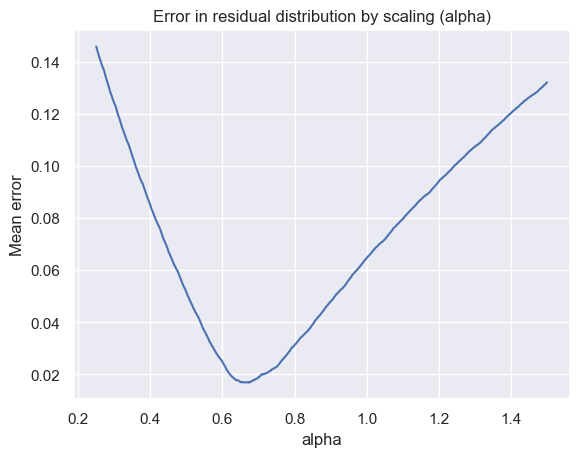

In [41]:
alpha_vals = np.linspace(0.25, 1.5, 1000)
errors_per_alpha = [get_corr(i) for i in alpha_vals]
plt.plot(alpha_vals, errors_per_alpha)
plt.ylabel("Mean error")
plt.xlabel("alpha")
plt.title("Error in residual distribution by scaling (alpha)")

Text(0.5, 0, 'actual inclusion')

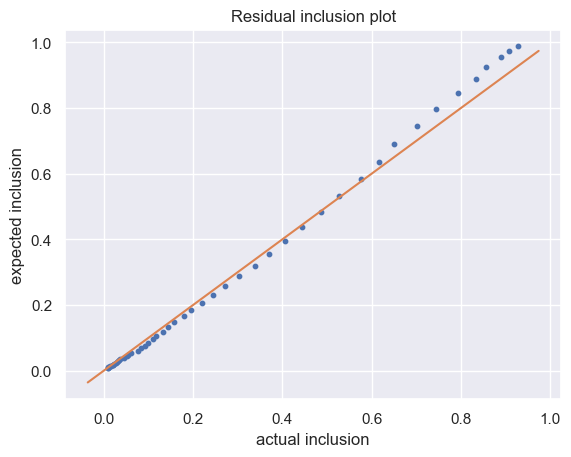

In [42]:
alpha = alpha_vals[np.argmin(errors_per_alpha)]
z_scores = np.geomspace(0.01, 2.5)
includeds = []
for z_score in z_scores:
    lower_bound = y_pred_arr - z_score * uncertainty * alpha
    upper_bound = y_pred_arr + z_score * uncertainty * alpha
    includeds.append(((lower_bound < y_true_arr) & (y_true_arr < upper_bound)).mean())
includeds = np.asarray(includeds)
plt.scatter(includeds, 1 - norm(0, 1).cdf(-np.absolute(z_scores)) * 2, s=10)
plt.plot(plt.gca().get_xlim(), plt.gca().get_xlim(), color="C1")
plt.title("Residual inclusion plot")
plt.ylabel("expected inclusion")
plt.xlabel("actual inclusion")

In [43]:
get_r2(includeds, 1 - norm(0, 1).cdf(-np.absolute(z_scores)) * 2)

0.9981560528523695

Make model on full training set

In [44]:
def get_full_model(model, feature_df, target_df):
    m = clone(model)
    m.set_params(eval_metric="RMSE")
    grid = {
        "iterations": [500, 1000, 2000, 5000],
        "learning_rate": [0.005, 0.01, 0.05, 0.1],
        "depth": [2, 4, 6, 8, 10],
        "l2_leaf_reg": [1, 3, 5, 7, 10],
        "min_data_in_leaf": [1, 5, 10, 20, 50],
        "subsample": [0.7, 0.8, 0.9, 1.0],
        "bagging_temperature": [0.1, 0.25, 0.5, 1],
        "random_strength": [1, 3, 5],
        "grow_policy": ["SymmetricTree", "Depthwise", "Lossguide"]
    }
    m.randomized_search(grid, feature_df, target_df)
    return m

In [45]:
full_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X[important_features]))
full_model = get_full_model(full_model, X[important_features], y)

0:	learn: 1398905.9893995	test: 1463224.6163647	best: 1463224.6163647 (0)	total: 4.54ms	remaining: 2.26s
1:	learn: 1386896.9690200	test: 1451373.3470236	best: 1451373.3470236 (1)	total: 8.74ms	remaining: 2.17s
2:	learn: 1375102.9729535	test: 1439650.8115039	best: 1439650.8115039 (2)	total: 12.9ms	remaining: 2.13s
3:	learn: 1363281.5807223	test: 1427967.9464794	best: 1427967.9464794 (3)	total: 17.6ms	remaining: 2.19s
4:	learn: 1351373.4878618	test: 1415903.1763542	best: 1415903.1763542 (4)	total: 21.8ms	remaining: 2.15s
5:	learn: 1340037.5416677	test: 1404576.8516413	best: 1404576.8516413 (5)	total: 27.4ms	remaining: 2.26s
6:	learn: 1328880.8408308	test: 1393569.0208494	best: 1393569.0208494 (6)	total: 32.1ms	remaining: 2.26s
7:	learn: 1317606.1263139	test: 1382292.2331476	best: 1382292.2331476 (7)	total: 35.3ms	remaining: 2.17s
8:	learn: 1306356.8319246	test: 1371211.1388910	best: 1371211.1388910 (8)	total: 39.4ms	remaining: 2.15s
9:	learn: 1295120.7652814	test: 1359801.3142764	best: 1

Make model to impute missing Estimated Average Stage Time in the test data

In [46]:
east_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(feature_dfs["Full"]))
east_model.fit(feature_dfs["Full"].loc[:, feature_dfs["Full"].columns != "Total Estimated Stage Time"], estimated_average_stage_times)

Learning rate set to 0.041222
0:	learn: 22.2153942	total: 1.97ms	remaining: 1.97s
1:	learn: 21.7726285	total: 2.56ms	remaining: 1.28s
2:	learn: 21.3107994	total: 4.1ms	remaining: 1.36s
3:	learn: 20.9213220	total: 5.2ms	remaining: 1.29s
4:	learn: 20.6131025	total: 5.58ms	remaining: 1.11s
5:	learn: 20.2310440	total: 6.49ms	remaining: 1.07s
6:	learn: 19.8682131	total: 7.8ms	remaining: 1.11s
7:	learn: 19.5325216	total: 8.64ms	remaining: 1.07s
8:	learn: 19.2195985	total: 9.97ms	remaining: 1.1s
9:	learn: 18.9004301	total: 10.7ms	remaining: 1.06s
10:	learn: 18.6034959	total: 11.2ms	remaining: 1s
11:	learn: 18.3470011	total: 11.9ms	remaining: 979ms
12:	learn: 18.1135701	total: 12.6ms	remaining: 953ms
13:	learn: 17.9269511	total: 13.3ms	remaining: 939ms
14:	learn: 17.6850675	total: 14.7ms	remaining: 967ms
15:	learn: 17.4422859	total: 16.6ms	remaining: 1.02s
16:	learn: 17.2518647	total: 17.9ms	remaining: 1.03s
17:	learn: 17.0518771	total: 18.6ms	remaining: 1.01s
18:	learn: 16.8535385	total: 19.5

Make model to predict ratio of diesel to cng in DGB

In [47]:
X, y = feature_dfs["DGB"], (get_target_df("DGB")["Diesel"] * diesel_scale) / (get_target_df("DGB")["CNG"] * cng_scale)
dgb_ratio_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X))
dgb_ratio_model = get_full_model(dgb_ratio_model, X, y)

0:	learn: 1.0376272	test: 0.7781980	best: 0.7781980 (0)	total: 2.31ms	remaining: 1.15s
1:	learn: 1.0344200	test: 0.7753384	best: 0.7753384 (1)	total: 5.27ms	remaining: 1.31s
2:	learn: 1.0313688	test: 0.7728524	best: 0.7728524 (2)	total: 7.97ms	remaining: 1.32s
3:	learn: 1.0284232	test: 0.7707682	best: 0.7707682 (3)	total: 15.8ms	remaining: 1.96s
4:	learn: 1.0254929	test: 0.7682118	best: 0.7682118 (4)	total: 18.8ms	remaining: 1.86s
5:	learn: 1.0225670	test: 0.7657636	best: 0.7657636 (5)	total: 21ms	remaining: 1.73s
6:	learn: 1.0197563	test: 0.7634697	best: 0.7634697 (6)	total: 24.5ms	remaining: 1.72s
7:	learn: 1.0168046	test: 0.7609726	best: 0.7609726 (7)	total: 26.8ms	remaining: 1.65s
8:	learn: 1.0139250	test: 0.7585207	best: 0.7585207 (8)	total: 29.4ms	remaining: 1.6s
9:	learn: 1.0110342	test: 0.7560440	best: 0.7560440 (9)	total: 32.2ms	remaining: 1.58s
10:	learn: 1.0080884	test: 0.7534978	best: 0.7534978 (10)	total: 35ms	remaining: 1.55s
11:	learn: 1.0058254	test: 0.7511444	best: 0.7

# Predict on test data

Read test data from "testing.csv" and remove extraneous whitespace in columns

In [48]:
test_df = pd.read_csv("testing.csv")
test_df.columns = [i.rstrip() for i in test_df.columns]

Drop target columns

In [49]:
test_df = test_df.dropna(axis=1, how="all")

Match transformations of training dataframe

In [50]:
test_df["Well Name 1"] = test_df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[0])
test_df["Well Name 2"] = test_df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[1])
test_df = test_df.drop("Well Name", axis=1)

In [51]:
X_at = test_df.loc[:, test_df.columns != "Ambient Temperature"]
for col in X_at.columns:
    if str(X_at[col].dtype) == "object":
        X_at = make_categorical(X_at, col)

y_at = test_df.loc[:, "Ambient Temperature"]

/var/folders/d0/rmsqt49959q7xz073h4cx29r0000gn/T/ipykernel_56901/1937108308.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/d0/rmsqt49959q7xz073h4cx29r0000gn/T/ipykernel_56901/1937108308.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/d0/rmsqt49959q7xz073h4cx29r0000gn/T/ipykernel_56901/1937108308.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

In [52]:
pred_at = pd.Series(at_model.predict(X_at[at_model.feature_names_]))
test_df["Ambient Temperature"] = test_df["Ambient Temperature"].fillna(pred_at)
test_df = test_df.drop("Field Area", axis=1)

In [53]:
test_df = test_df.drop("Sand Provider", axis=1)

In [54]:
for col in test_df.columns:
    if str(test_df[col].dtype) == "object":
        test_df = make_categorical(test_df, col)

Impute missing estimated average stage time values using model from train set

In [55]:
pred_east = pd.Series(east_model.predict(test_df.loc[:, [i for i in test_df.columns if i in feature_dfs["Full"].columns]]))
test_df["Estimated Average Stage Time"] = test_df["Estimated Average Stage Time"].fillna(pred_east)

In [56]:
test_df["Total Estimated Stage Time"] = test_df["Estimated Average Stage Time"] * test_df["# Stages"]
estimated_average_stage_times = test_df["Estimated Average Stage Time"]
test_df = test_df.drop("Estimated Average Stage Time", axis=1)
test_df = test_df.drop("# Stages", axis=1)

Get predictions

In [57]:
test_df.loc[:, "Predictions"] = full_model.predict(test_df.loc[:, important_features])

In [58]:
def gaussian_within_percent_range(mean, percent, size=1000):
    """
    Generate Gaussian random numbers centered around a mean within a percentage range.

    Parameters:
        mean (float): The center of the Gaussian distribution.
        percent (float): The percentage range around the mean (e.g., 10 for ±10%).
        size (int): Number of random numbers to generate.

    Returns:
        np.ndarray: Array of random numbers within the specified range.
    """
    # Calculate range boundaries
    lower_bound = mean * (1 - percent / 100)
    upper_bound = mean * (1 + percent / 100)
    
    # Standard deviation as a fraction of mean (adjustable)
    std_dev = (upper_bound - lower_bound) / 4  # Roughly fits ±2σ within the range
    
    # Generate values and filter within bounds
    while True:
        value = np.random.normal(mean, std_dev)
        if lower_bound <= value <= upper_bound:
            return value

## Realizations

In [59]:
categorical_columns = get_categorical_columns(test_df.loc[:, important_features])
non_categorical_columns = [i for i in test_df.loc[:, important_features].columns if i not in categorical_columns]
perturbation_indices = [i for i in range(len(test_df.loc[:, important_features].columns)) if test_df.loc[:, important_features].columns[i] in non_categorical_columns]

In [67]:
def get_realizations_for_row(row_index):

    row = test_df.loc[row_index, important_features]

    y_perturbed = []

    for i in range(100):
        row_copy = row.copy()
        for index in perturbation_indices:
            row_copy.iloc[index] = gaussian_within_percent_range(row.iloc[index], 5)
        y_perturbed.append(full_model.predict(row_copy))
    
    return y_perturbed

## Make submission dataframe

In [68]:
submission_df = pd.read_csv("solution.csv")

In [69]:
for i in range(len(submission_df)):
    fuel_type = submission_df.iloc[i]["Fuel Type"]
    name1, name2 = submission_df.iloc[i]["Masked Well Name"].rsplit(" ", 1)
    row = test_df[(test_df["Well Name 1"] == name1) & (test_df["Well Name 2"] == name2)]
    realizations = get_realizations_for_row(row.index[0])
    if len(row["Predictions"]) > 1:
        row = row[row["Fuel Type"] == fuel_type.split("_")[0]]
    pred = float(row["Predictions"])
    if fuel_type == "Grid":
        submission_df.loc[i, "Fuel Value"] = pred
        for j in range(100):
            submission_df.loc[i, f"R_{j+1}"] = realizations[j]
    elif fuel_type == "Turbine":
        submission_df.loc[i, "Fuel Value"] = pred / cng_scale
        for j in range(100):
            submission_df.loc[i, f"R_{j+1}"] = realizations[j] / cng_scale
    elif fuel_type == "Diesel":
        submission_df.loc[i, "Fuel Value"] = pred / diesel_scale
        for j in range(100):
            submission_df.loc[i, f"R_{j+1}"] = realizations[j] / diesel_scale
    else:
        if fuel_type == "DGB_CNG":
            ratio = dgb_ratio_model.predict(row[dgb_ratio_model.feature_names_])
            prop = 1 / (ratio + 1)
            submission_df.loc[i, "Fuel Value"] = pred * prop / cng_scale
            for j in range(100):
                submission_df.loc[i, f"R_{j+1}"] = realizations[j] * prop / cng_scale
        elif fuel_type == "DGB_Diesel":
            ratio = dgb_ratio_model.predict(row[dgb_ratio_model.feature_names_])
            prop = 1 / (1 + (1 / ratio))
            submission_df.loc[i, "Fuel Value"] = pred * prop / diesel_scale
            for j in range(100):
                submission_df.loc[i, f"R_{j+1}"] = realizations[j] * prop / diesel_scale

Analyze the results

In [70]:
# Generate random data that follows a normal distribution (for demonstration)
def create_norm_plot(row_number):
    # Create the histogram and fit the normal curve
    row = submission_df.iloc[row_number, 3:].to_numpy()
    row = row.flatten()
    row = row.astype(float)
    
    sns.histplot(row, kde=True, stat="density", color="blue", bins=10)

    # Fit a normal distribution to the data
    mu, std = norm.fit(row)

    # Plot the normal distribution curve
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, "k", linewidth=2)

    # Add a red vertical line at a specific value (e.g., x = 0)
    value_to_mark = submission_df.iloc[row_number, 2]
    plt.axvline(x=value_to_mark, color="red", linestyle="--", linewidth=2)

    # Add labels and title
    plt.title("Histogram with Normal Curve and Red Mark")
    plt.xlabel("X-axis")
    plt.ylabel("Density")

    # Show the plot
    plt.show()


slider = widgets.IntSlider(value=0, min=0, max=len(submission_df)-1, step=1, description='Index:')
widgets.interactive(create_norm_plot, row_number=slider)

interactive(children=(IntSlider(value=0, description='Index:', max=62), Output()), _dom_classes=('widget-inter…

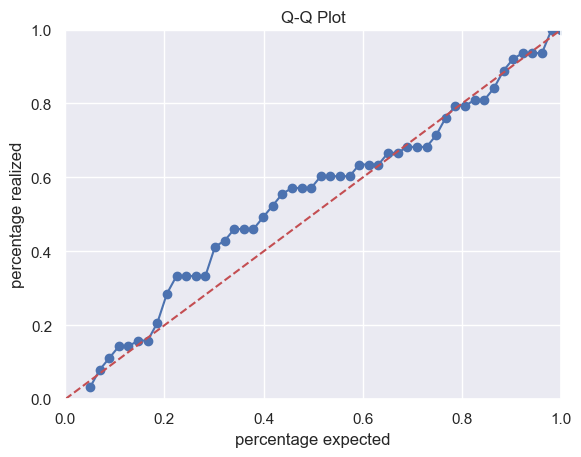

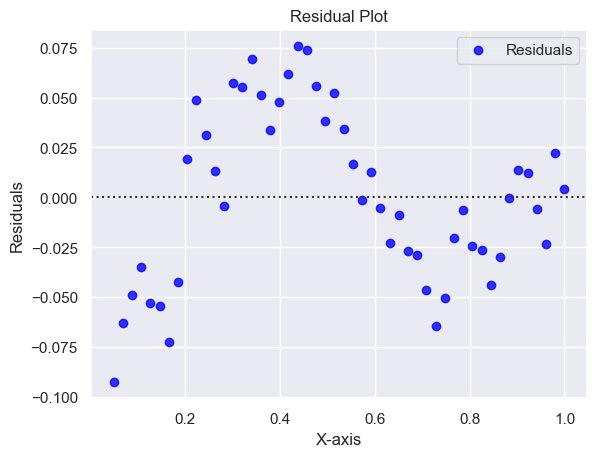

In [71]:
def xi(row_number, p):
    values_to_sort = submission_df.iloc[row_number, 3:105]
    sorted_values = values_to_sort.sort_values().values
    i = 0
    value = submission_df.iloc[row_number, 2]
    while (i < 99 and value >= sorted_values[i]):
        i += 1

    i = i/100.0
    if i > (1.-p)/2 and i <= (1.+p)/2:
        return 1
    return 0

def xi_bar(p, n=63):
    return sum([xi(i, p) for i in range(n)]) / n

def a(p):
    return int(xi_bar(p) >= p)
     
x = np.linspace(0.05, 1.00)

vectorized_function = np.vectorize(xi_bar)
y = vectorized_function(x)


plt.plot(x, y, "o-", label="Scatter connected")  
plt.plot([0, 1], [0, 1], "r--")  

plt.xlim(0, 1)
plt.ylim(0, 1)

plt.xlabel("percentage expected")
plt.ylabel("percentage realized")
plt.title("Q-Q Plot")
plt.show()

y_pred = x 
residuals = y - y_pred

plt.figure()
sns.residplot(x=x, y=residuals, lowess=False, color="blue", line_kws={"color": "red"}, label="Residuals")

plt.xlabel("X-axis")
plt.ylabel("Residuals")
plt.title("Residual Plot")

plt.legend()
plt.show()



In [72]:
# Define goodness measure
def G():
    p_arr = np.arange(0.05, 1.00, 0.05)
    sum = 0.0
    for i in range(p_arr.size):
        xbar = xi_bar(p_arr[i])
        sum += (3*(1 if xbar >= p_arr[i] else 0) - 2)*(xbar - p_arr[i])*0.05
    return 1-sum

print(G())

0.9473015873015873


In [73]:
submission_df.to_csv("solution.csv", index=False)